In [1]:
#rdkit関連のimport
from rdkit import Chem
from rdkit.Chem import AllChem, PandasTools

#その他のimport
import matplotlib as mpl
import matplotlib.pyplot as plt
import pandas as pd
import glob
import re


#SDFファイルの読み込み
mol_list  = Chem.SDMolSupplier("../../ForMolPredict/SDF_files/Ames/Ames_AllMol.sdf",removeHs=False) 
mol_num = len(mol_list)
print("there are {} molecules".format(mol_num))

there are 6134 molecules


In [5]:
#データの抽出
act_list = [mol.GetDoubleProp('Activity') for mol in mol_list]
mol_props = ['Volume', 'Energy', 'HOMO', 'LUMO', 'HLgap', 'Mcharge_ave', 'Mcharge_var', 'Lcharge_ave', 'Lcharge_var', 'dipole', 'Atom_num', 'Mass', 'Density']
maccskeys = []
calc_list = []
FC_list = []
for mol in mol_list:
    maccskey = [float(x) for x in AllChem.GetMACCSKeysFingerprint(mol)]
    maccskeys.append(maccskey)
    mol_data = [mol.GetDoubleProp(prop) for prop in mol_props]
    calc_list.append(mol_data)
    FC = maccskey + mol_data
    FC_list.append(FC)

RDKit WARNING: [09:41:52] Warning: molecule is tagged as 3D, but all Z coords are zero
[09:41:52] Warning: molecule is tagged as 3D, but all Z coords are zero
RDKit WARNING: [09:41:53] Warning: molecule is tagged as 3D, but all Z coords are zero
[09:41:53] Warning: molecule is tagged as 3D, but all Z coords are zero
RDKit WARNING: [09:41:53] Warning: molecule is tagged as 3D, but all Z coords are zero
[09:41:53] Warning: molecule is tagged as 3D, but all Z coords are zero
RDKit WARNING: [09:41:54] Warning: molecule is tagged as 3D, but all Z coords are zero
[09:41:54] Warning: molecule is tagged as 3D, but all Z coords are zero
RDKit WARNING: [09:41:56] Warning: molecule is tagged as 3D, but all Z coords are zero
[09:41:56] Warning: molecule is tagged as 3D, but all Z coords are zero
RDKit WARNING: [09:41:56] Warning: molecule is tagged as 3D, but all Z coords are zero
[09:41:56] Warning: molecule is tagged as 3D, but all Z coords are zero
RDKit WARNING: [09:42:02] Warning: molecule is

In [10]:
print('number of Fingerprint:',len(maccskeys[0]))
print('number of Calclation Data:', len(calc_list[0]))
print('number of All Data:', len(FC_list[0]))

number of Fingerprint: 167
number of Calclation Data: 13
number of All Data: 180


In [13]:
#activityのカウント
print('number of 0.0: ',act_list.count(0.0))
print('number of 1.0: ',act_list.count(1.0))

number of 0.0:  2808
number of 1.0:  3326


In [14]:
#無制限の決定木
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(maccskeys, act_list, random_state= 0)
xcalc_train, xcalc_test, ycalc_train, ycalc_test = train_test_split(calc_list, act_list, random_state= 0)
xFC_train, xFC_test, yFC_train, yFC_test = train_test_split(FC_list, act_list, random_state= 0)

tree = DecisionTreeClassifier(random_state= 0)
tree.fit(x_train, y_train)
print('=======Only Rdkit Finger Print========')
print('accuracy on train set: {:.3f}'.format(tree.score(x_train, y_train)))
print('accuracy on test set: {:.3f}'.format(tree.score(x_test, y_test)))

calc_tree = DecisionTreeClassifier(random_state= 0)
calc_tree.fit(xcalc_train, ycalc_train)
print('=======Only Calculation Results========')
print('accuracy on train set: {:.3f}'.format(calc_tree.score(xcalc_train, ycalc_train)))
print('accuracy on test set: {:.3f}'.format(calc_tree.score(xcalc_test, ycalc_test)))

FC_tree = DecisionTreeClassifier(random_state= 0)
FC_tree.fit(xFC_train, yFC_train)
print('=======Calculation Results + Rdkit Finger Print========')
print('accuracy on train set: {:.3f}'.format(FC_tree.score(xFC_train, yFC_train)))
print('accuracy on test set: {:.3f}'.format(FC_tree.score(xFC_test, yFC_test)))

=======Only Rdkit Finger Print========
accuracy on train set: 0.971
accuracy on test set: 0.756
=======Only Calculation Results========
accuracy on train set: 1.000
accuracy on test set: 0.658
=======Calculation Results + Rdkit Finger Print========
accuracy on train set: 1.000
accuracy on test set: 0.724


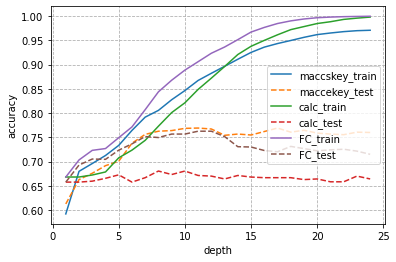

In [19]:
## 決定木の調整
accs_train = []
accs_test = []
accs_calc_train = []
accs_calc_test = []
accs_FC_train = []
accs_FC_test = []
deep = 25
depth = range(1,deep)
for i in depth:
    tree2 = DecisionTreeClassifier(max_depth=i, random_state=0)
    tree2.fit(x_train, y_train)
    acc_train = tree2.score(x_train, y_train)
    acc_test = tree2.score(x_test, y_test)
    accs_train.append(acc_train)
    accs_test.append(acc_test)
for j in depth:
    calc_tree2 = DecisionTreeClassifier(max_depth=j, random_state=0)
    calc_tree2.fit(xcalc_train, ycalc_train)
    acc_calc_train = calc_tree2.score(xcalc_train, ycalc_train)
    acc_calc_test = calc_tree2.score(xcalc_test, ycalc_test)
    accs_calc_train.append(acc_calc_train)
    accs_calc_test.append(acc_calc_test)
for k in depth:
    FC_tree2 = DecisionTreeClassifier(max_depth=k, random_state=0)
    FC_tree2.fit(xFC_train, yFC_train)
    acc_FC_train = FC_tree2.score(xFC_train, yFC_train)
    acc_FC_test = FC_tree2.score(xFC_test, yFC_test)
    accs_FC_train.append(acc_FC_train)
    accs_FC_test.append(acc_FC_test)
    
#graph
plt.plot(depth, accs_train, label = 'maccskey_train', linestyle="solid")
plt.plot(depth, accs_test, label = 'maccekey_test', linestyle="dashed")

plt.plot(depth, accs_calc_train, label = 'calc_train', linestyle="solid")
plt.plot(depth, accs_calc_test, label = 'calc_test', linestyle="dashed")

plt.plot(depth, accs_FC_train, label = 'FC_train', linestyle="solid")
plt.plot(depth, accs_FC_test, label = 'FC_test', linestyle="dashed")


# 凡例を表示
plt.legend(loc=5)
# グリッド
plt.grid(linestyle='--')
#軸ラベル
plt.xlabel('depth')
plt.ylabel('accuracy')

plt.show()

In [29]:
from dtreeviz.trees import dtreeviz
import numpy as np
maccskey_name = list(range(len(maccskeys[0])))
FC_name = maccskey_name + mol_props

print('=======Only Rdkit Finger Print========')
tree_maccskey = DecisionTreeClassifier(max_depth=10, random_state=0)
tree_maccskey.fit(x_train, y_train)
viz_pre_maccs = dtreeviz(tree_maccskey, np.array(x_train), np.array(y_train), target_name= 'mutagenicity', feature_names=maccskey_name, class_names=['nagative', 'positive'], orientation='LR', histtype='bar')
display(viz_pre_maccs)

print('=======Only Calculation Results========')
tree_calc = DecisionTreeClassifier(max_depth=10, random_state=0)
tree_calc.fit(xcalc_train, ycalc_train)
viz_pre_calc  = dtreeviz(tree_calc, np.array(xcalc_train), np.array(ycalc_train), target_name= 'mutagenicity', feature_names=mol_props, class_names=['nagative', 'positive'], orientation='LR', histtype='bar')
display(viz_pre_calc)

print('=======Calculation Results + Rdkit Finger Print========')
tree_FC = DecisionTreeClassifier(max_depth=10, random_state=0)
tree_FC.fit(xFC_train, yFC_train)
viz_pre_FC = dtreeviz(tree_FC, np.array(xFC_train), np.array(yFC_train), target_name= 'mutagenicity', feature_names=FC_name, class_names=['nagative', 'positive'], orientation='LR', histtype='bar')
display(viz_pre_FC)

=======Only Rdkit Finger Print========


=======Only Calculation Results========


=======Calculation Results + Rdkit Finger Print========
